In [1]:
%load_ext autoreload
%autoreload 2

import scanpy as sc
import yaml
from tools.hovernet_tools import extract_tiles_hovernet, map_cells_to_spots
from tools import slide_viz, slide_viz_int

/home/luca/anaconda3/envs/plugin-env/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
st_dataname = "CytAssist_11mm_FFPE_Human_Ovarian_Carcinoma"

path_ST_data = f"../data/{st_dataname}/ST/"
image_path = f"../data/{st_dataname}/CytAssist_11mm_FFPE_Human_Ovarian_Carcinoma_tissue_image.tif"
json_path = f"../data/{st_dataname}/seg_json/pannuke_fast_mask_lvl3.json"

# Load the dictionary with the types and colors
dict_types_colors_path = "../config/dict_types_segmentation.yaml"
with open(dict_types_colors_path, 'r') as file:
    dict_types_colors = yaml.load(file, Loader=yaml.FullLoader)

# Load the ST data
st_adata = sc.read_visium(path_ST_data)

/home/luca/anaconda3/envs/plugin-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/luca/anaconda3/envs/plugin-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [3]:
window = ((15000, 4000), (2000, 2000))

In [4]:
plotter = slide_viz.SlideVisualizer(image_path, 
                          adata = st_adata, 
                          adata_name = st_dataname, 
                          dict_cells = json_path, 
                          dict_types_colors = dict_types_colors["pannuke"], 
                          window = window)

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


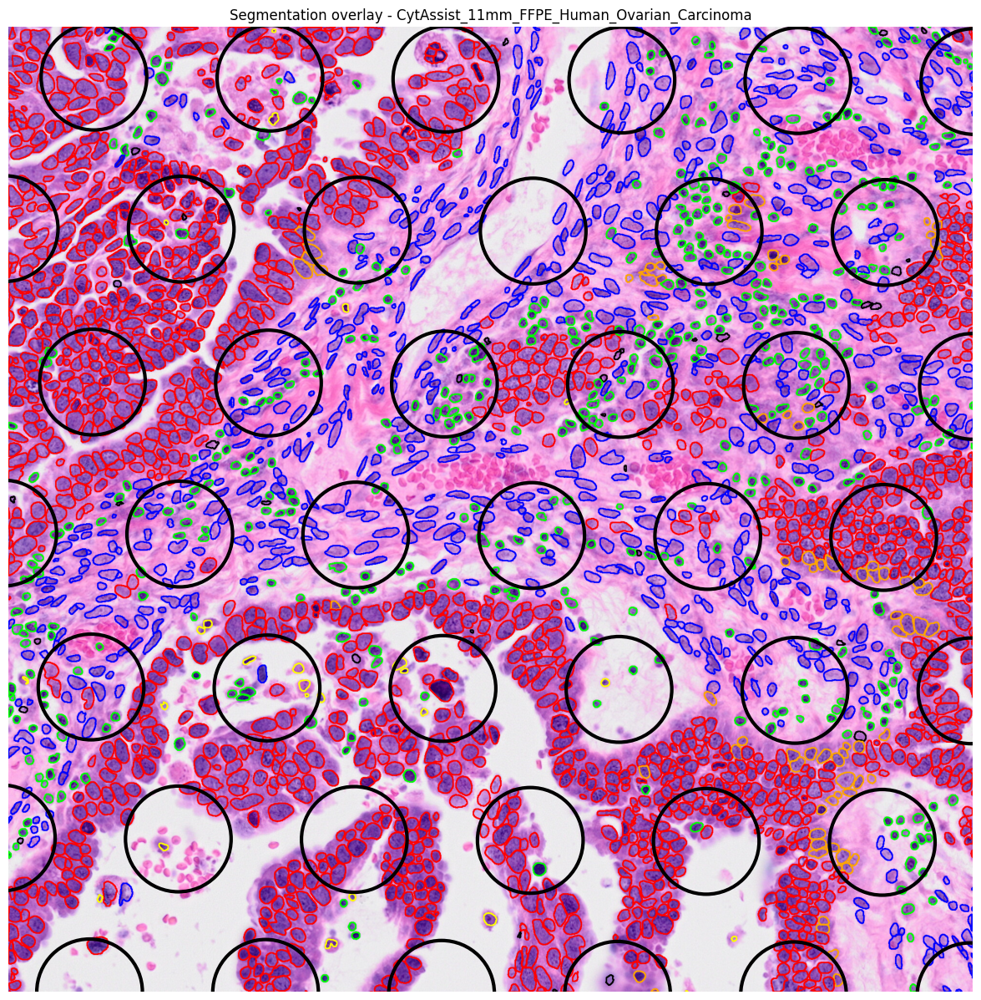

In [5]:
plotter.plot_seg(show_visium=True, draw_dot=False)

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


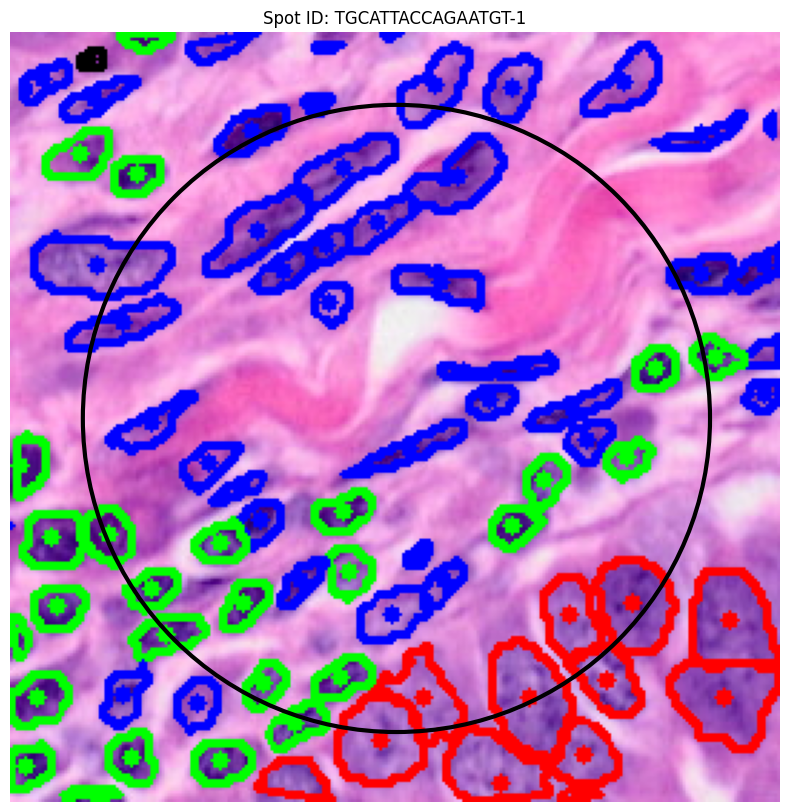

Spot ID: TGCATTACCAGAATGT-1


In [6]:
slide_viz.plot_specific_spot(image_path, 
                             st_adata, 
                             st_dataname, 
                             spot_id="TGCATTACCAGAATGT-1", 
                             dict_cells=json_path, 
                             dict_types_colors=dict_types_colors["pannuke"])

In [7]:
plotter_int = slide_viz_int.SlideVisualizer(image_path, 
                                            st_adata, 
                                            st_dataname, 
                                            dict_cells=json_path, 
                                            dict_types_colors=dict_types_colors["pannuke"], 
                                            window=window)

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


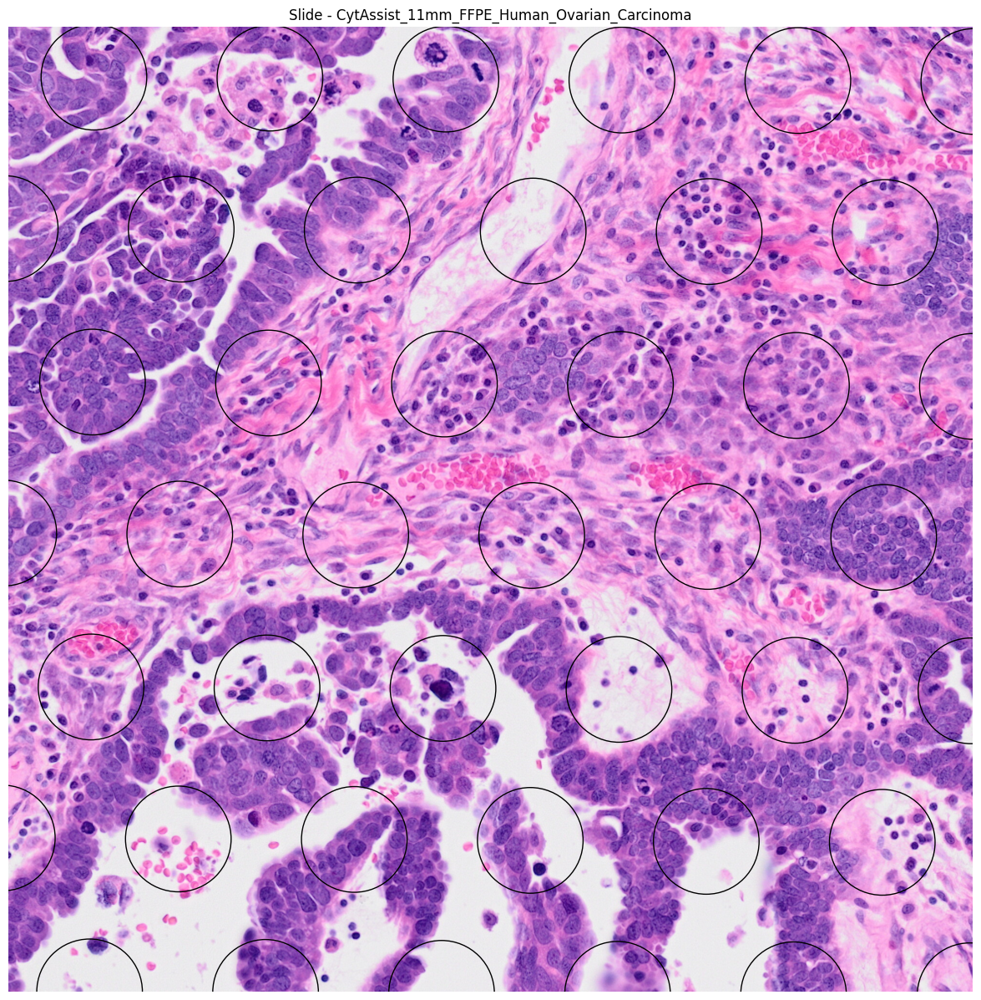

In [8]:
plotter_int.plot_slide(show_visium=True)

In [9]:
plotter_int.plot_seg(show_visium=True)

In [11]:
slide_viz_int.plot_specific_spot(image_path, 
                                 st_adata, 
                                 st_dataname, 
                                 spot_id="GCCGTACAGTGGTAGA-1", 
                                 dict_cells=json_path, 
                                 dict_types_colors=dict_types_colors["pannuke"])

TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


Spot ID: GCCGTACAGTGGTAGA-1


In [11]:
dict_cell2spot = map_cells_to_spots(st_adata, st_dataname, json_path)

Mapping cells to spots: 100%|██████████| 352093/352093 [00:02<00:00, 139558.29it/s]


In [16]:
len(dict_cell2spot["TGCATTACCAGAATGT-1"])

39

## Extract tiles from Hovernet results

In [ ]:
# level = 0
# size = (64, 64)
# dict_types = {0 : "nolabe", 
#               1 : "neopla", 
#               2 : "inflam", 
#               3 : "connec", 
#               4 : "necros", 
#               5 : "no-neo"}
# out_dir = "data/CytAssist_11mm_FFPE_Human_Ovarian_Carcinoma/img/"

# extract_tiles_hovernet(image_path, json_path, dict_types, out_dir, level, size)

100%|██████████| 352093/352093 [25:06<00:00, 233.76it/s] 
